In [15]:
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


In [16]:
graph_f = open('../build/tests/data/bipartite.bin', 'rb')

In [17]:
num_nodes = np.fromfile(graph_f, dtype=np.uint32, count=1)[0]

In [18]:
adj_list = []
for i in range(num_nodes):
    cur_nnbrs = np.fromfile(graph_f, dtype=np.uint32, count=1)[0]
    nbrs = np.fromfile(graph_f, dtype=np.uint32, count=cur_nnbrs)
    adj_list.append(nbrs.tolist())


In [19]:
g = nx.DiGraph()
for i in range(num_nodes):
    for j in adj_list[i]:
        g.add_edge(i, j)

In [20]:
indegrees = [val for (node, val) in g.in_degree()]
indegrees

[13,
 19,
 9,
 28,
 18,
 15,
 21,
 21,
 24,
 38,
 15,
 23,
 15,
 29,
 17,
 13,
 25,
 13,
 4,
 15,
 20,
 19,
 17,
 15,
 16,
 14,
 19,
 14,
 25,
 28,
 18,
 17,
 20,
 10,
 16,
 22,
 27,
 12,
 17,
 15,
 35,
 15,
 18,
 34,
 24,
 28,
 19,
 22,
 16,
 13,
 16,
 20,
 24,
 14,
 10,
 15,
 23,
 20,
 10,
 20,
 26,
 16,
 13,
 14,
 27,
 43,
 19,
 25,
 19,
 17,
 20,
 20,
 18,
 18,
 16,
 21,
 15,
 10,
 35,
 11,
 20,
 19,
 13,
 12,
 16,
 27,
 11,
 16,
 16,
 5,
 17,
 14,
 19,
 17,
 19,
 18,
 8,
 17,
 7,
 27,
 17,
 16,
 27,
 18,
 20,
 20,
 25,
 10,
 17,
 24,
 21,
 29,
 16,
 22,
 12,
 17,
 17,
 16,
 9,
 24,
 11,
 18,
 28,
 19,
 16,
 37,
 29,
 38,
 12,
 36,
 23,
 30,
 15,
 21,
 15,
 15,
 22,
 24,
 18,
 15,
 30,
 15,
 23,
 33,
 16,
 19,
 13,
 17,
 19,
 14,
 31,
 22,
 20,
 31,
 14,
 16,
 21,
 26,
 37,
 23,
 11,
 17,
 16,
 13,
 23,
 22,
 15,
 16,
 15,
 15,
 20,
 18,
 21,
 20,
 15,
 26,
 18,
 38,
 18,
 15,
 22,
 17,
 31,
 26,
 28,
 17,
 18,
 17,
 27,
 17,
 25,
 23,
 27,
 20,
 29,
 20,
 21,
 32,
 15,
 16,
 19,
 

In [14]:
nx.is_strongly_connected(g)

False

In [11]:
pd.DataFrame(indegrees)

,0
0,35
1,25
2,12
3,18
4,21
...,...
19995,18
19996,18
19997,17
19998,0


In [21]:
strong_comp = nx.strongly_connected_components(g)

In [22]:
comp_cnt = 0
for comp in strong_comp:
    print(comp)
    comp_cnt = comp_cnt + 1

comp_cnt

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221,

3

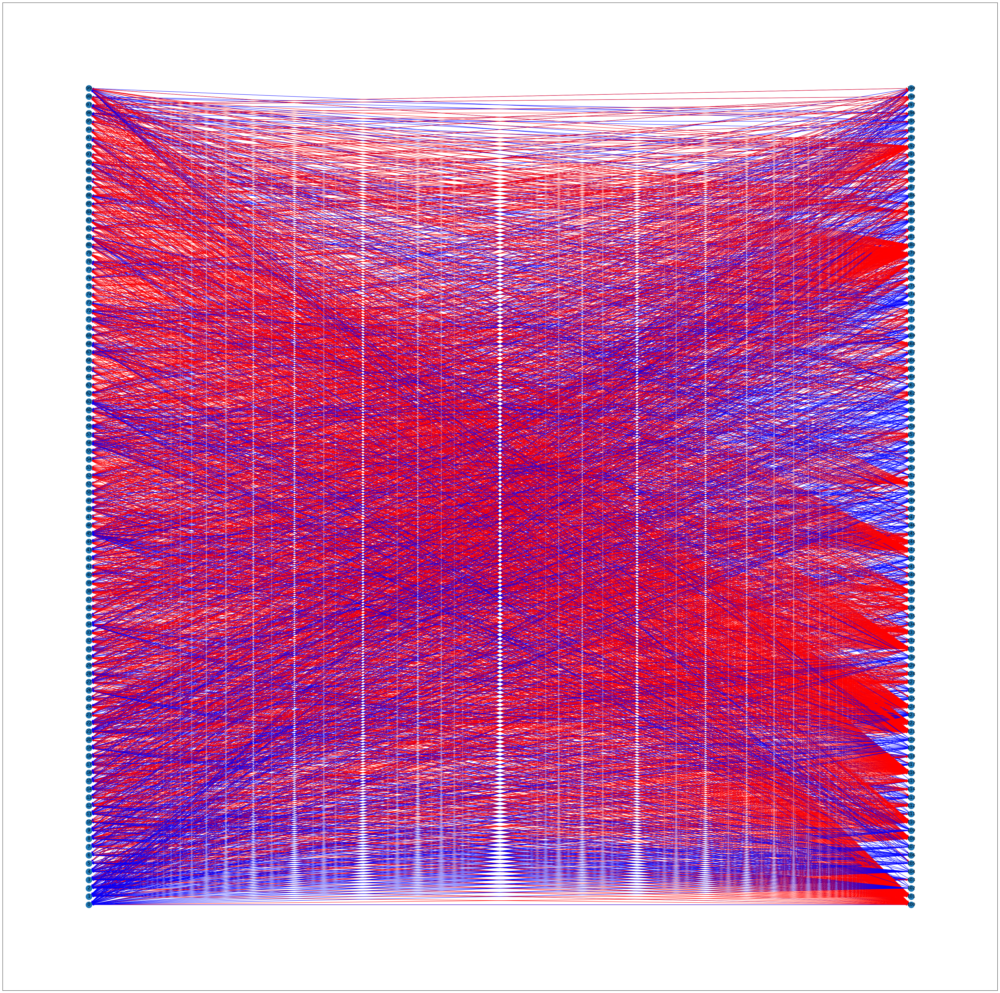

In [ ]:
X, Y = nx.bipartite.sets(g)
pos = nx.drawing.layout.bipartite_layout(g, X)

# Iterate over the edges and set the edge color based on in/out degree
edge_colors = []
for u, v in g.edges():
    if v in Y:  # This is an outgoing edge (from X to Y)
        edge_colors.append('red')
    else:  # This is an incoming edge (from Y to X)
        edge_colors.append('blue')

plt.figure(figsize=(50, 50))
nx.draw_networkx(
    g,
    pos=pos,
    edge_color=edge_colors,
)


In [ ]:
# networkx out degree fo each node, convert to data frame
indegree = dict(g.in_degree())
outdegree = dict(g.out_degree())
# degree to dataframe
indegree_df = pd.DataFrame.from_dict(indegree, orient='index')
outdegree_df = pd.DataFrame.from_dict(outdegree, orient='index')


In [ ]:
indegree_df = indegree_df.reset_index().sort_values(by=['index']).set_index('index')
outdegree_df = outdegree_df.reset_index().sort_values(by=['index']).set_index('index')

In [ ]:
ll = []
for x in range(num_nodes):
    ll.append(0 if x < 100 else 1)
indegree_df['cate'] = ll 
outdegree_df['cate'] = ll

In [ ]:
indegree_df.groupby(by='cate').mean()

,0
cate,
0,18.87
1,18.79


In [ ]:
outdegree_df.groupby(by='cate').mean()

,0
cate,
0,18.79
1,18.87


In [ ]:
indegree_df.describe()

,0,cate
count,200.000000,200.000000
mean,18.830000,0.500000
std,19.182307,0.501255
min,0.000000,0.000000
25%,5.000000,0.000000
50%,15.000000,0.500000
75%,23.000000,1.000000
max,100.000000,1.000000


In [ ]:
outdegree_df.describe()

,0,cate
count,200.00000,200.000000
mean,18.83000,0.500000
std,0.41468,0.501255
min,17.00000,0.000000
25%,19.00000,0.000000
50%,19.00000,0.500000
75%,19.00000,1.000000
max,19.00000,1.000000


In [ ]:
indegree_df.loc[88], outdegree_df.loc[88]

(0       11
 cate     0
 Name: 88, dtype: int64,
 0       18
 cate     0
 Name: 88, dtype: int64)